---
title: Stable diffusion using 🤗 Hugging Face - Introduction
author: Prajwal Suresh
date: "2022-11-22"
categories: [Stable Diffusion]
image: "01.png"
format:
    html:
        code-fold: false
        number-sections: true
---

> Introduction to using 🤗 [Hugging face](https://huggingface.co/) - [Diffusers library](https://github.com/huggingface/diffusers) for Stable Diffusion, looking into the core components and implementing StableDiffusionPipeline using it



<div align="center">
  <a href="https://colab.research.google.com/github/prajwal-suresh13/image_colorization/blob/master/image_colorization_cyclegan_training.ipynb"> <img src=https://colab.research.google.com/assets/colab-badge.svg width=150> </a>
</div> <br>

In this post I will give an introduction on using 🤗 Diffusers library to generate images using texts as input. This blog is based on the knowledge acquired while doing the [*‘From Deep learning foundations to Stable Diffusion’*](https://www.fast.ai/posts/part2-2022.html) course by [FastAI](https://www.fast.ai/posts/part2-2022.html) . The first few lessons of the FastAI course are publicly available [here](https://www.fast.ai/posts/part2-2022-preview.html). Until the rest of the lessons are available, you can also checkout the first part of the [course](https://course.fast.ai/) which is one of the best Deep Learning courses

At first, let's install the diffusers library

In [ ]:
#| output: false
!pip install -Uq accelerate transformers diffusers ftfy

     |████████████████████████████████| 175 kB 14.2 MB/s 
     |████████████████████████████████| 5.5 MB 83.3 MB/s 
     |████████████████████████████████| 304 kB 73.8 MB/s 
     |████████████████████████████████| 53 kB 1.8 MB/s 
     |████████████████████████████████| 7.6 MB 52.2 MB/s 
     |████████████████████████████████| 182 kB 92.3 MB/s 


# What is Stable Diffusion

Stable Diffusion is a popular text-to-image model. It is a deep learning model which takes a sentence as input and generates an image which represents the text. You can find amazing examples of images generated by the model with just text as input on the [Lexica](https://lexica.art/) website. Stable Diffusion model can also take an image and text as input, modify the provided image and generate new images based on text.


<figure align = "center">
<img src="https://pbs.twimg.com/media/FePCGVNXkAIAGG2.jpg" width="800">
    <figcaption align = "center">
        <h4>Fig 1: Stable Diffusion <a href="https://jalammar.github.io/illustrated-stable-diffusion/">(Image Credit)</a></h4>
</figcaption>
</figure>

# Getting started with HuggingFace diffusers library

## Creating HuggingFace account and accepting the model license
At first, you will have to create a HuggingFace account by going to this [link](https://huggingface.co/join). HuggingFace provides many pretrained models for Stable Diffusion. In order to use the model, you have to accept the model license. The pretrained model we are using is ```CompVis/stable-diffusion-v1-4``` .Click on this [link](https://huggingface.co/CompVis/stable-diffusion-v1-4?text=A+pikachu+fine+dining+with+a+view+to+the+Eiffel+Tower) to accept the model license

## Token generation

User Access Tokens are the preferred way by HuggingFace to authenticate an application or notebook to Huggingface services. You can learn more about it in their [documentation](https://huggingface.co/docs/hub/security-tokens#:~:text=There%20are%20plenty%20of%20ways,git%20or%20with%20basic%20authentication.)

To create an access token, click on top right icon, go to Settings. Select Access Tokens and New Token. Give the token a name and the role. For  following along with this post read role is sufficient. Click on Generate a Token. You can find the newly created token under User Access Token. Copy the generated token. On running  ```notebook_login()``` command, you will be prompted to enter the token which will provide access to HuggingFace services through Jupyter Notebook

In [ ]:
from huggingface_hub import notebook_login
notebook_login()

Token is valid.
Your token has been saved in your configured git credential helpers (store).
Your token has been saved to /root/.huggingface/token
Login successful


## StableDiffusionPipeline
Next we will import the required libraries. We will set a variable ```torch_device``` to "cuda" if GPU is available else to "cpu". The ```image_grid``` function is useful to visualize the results obtained from the StableDiffusionPipeline.

In [ ]:
#| code-fold: true
import torch
from torch import autocast
from torchvision import transforms as tfms

from transformers import CLIPTextModel, CLIPTokenizer
from transformers import logging
logging.set_verbosity_error() # Suppress unnecessary warning from CLIPTextModel

from diffusers import StableDiffusionPipeline, AutoencoderKL, UNet2DConditionModel, LMSDiscreteScheduler

from PIL import Image
from matplotlib import pyplot as plt
import numpy as np
from pathlib import Path
from tqdm.auto import tqdm

In [ ]:
#checks if gpu is available if not cpu is used
torch_device = "cuda" if torch.cuda.is_available() else "cpu"

In [ ]:
def image_grid(imgs, rows, cols):
    w,h = imgs[0].size
    grid = Image.new("RGB", size=(cols*w, rows*h))
    for i, img in enumerate(imgs):grid.paste(img, box=(i%cols*w, i//cols*h))
    return grid

Next step is to import the StableDiffusionPipeline from diffusers library & download the  model weights. The model weights are stored in Huggingface repo. We have to provide the repo path to  ```from_pretrained```. In our case the repo path is ```CompVis/stable-diffusion-v1-4``` model. We then move it to GPU if available

In [ ]:
from diffusers import StableDiffusionPipeline

pipe = StableDiffusionPipeline.from_pretrained("CompVis/stable-diffusion-v1-4").to(torch_device)

Downloading:   0%|          | 0.00/543 [00:00<?, ?B/s]

Fetching 16 files:   0%|          | 0/16 [00:00<?, ?it/s]

Downloading:   0%|          | 0.00/342 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/4.56k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.22G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/209 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/313 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/592 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/492M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/472 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/806 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/743 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/3.44G [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/522 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/335M [00:00<?, ?B/s]

Now let's pass a textual prompt to the pretrained model to generate image 

  0%|          | 0/51 [00:00<?, ?it/s]

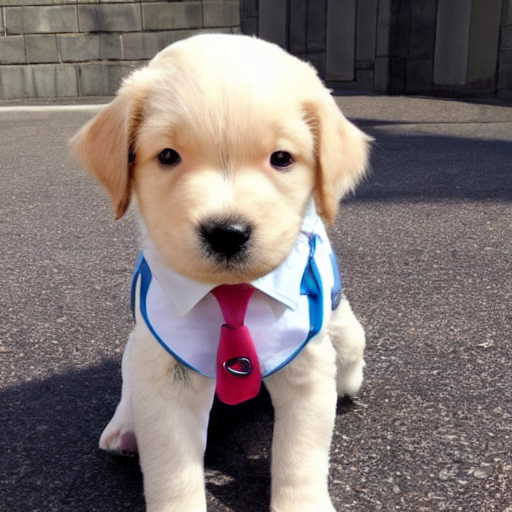

In [ ]:
#| fig-align: center
torch.manual_seed(9000)
prompt = "a photo of a puppy wearing suit"
pipe(prompt).images[0]

<figcaption align = "center">
        <h4>Fig 2: An example of image generated by the StableDiffusion pipeline </h4>
</figcaption>

<p></p>
You can also pass multiple textual prompts and the pipeline will generate images for each prompt

In [ ]:
prompts =['a photograph of a dog wearing hat and glasses',
          'a photograph of an astronaut riding horse ',
          'an oil painting of dog']

In [ ]:
torch.manual_seed(9000)
images = pipe(prompts).images
len(images)

  0%|          | 0/51 [00:00<?, ?it/s]

3

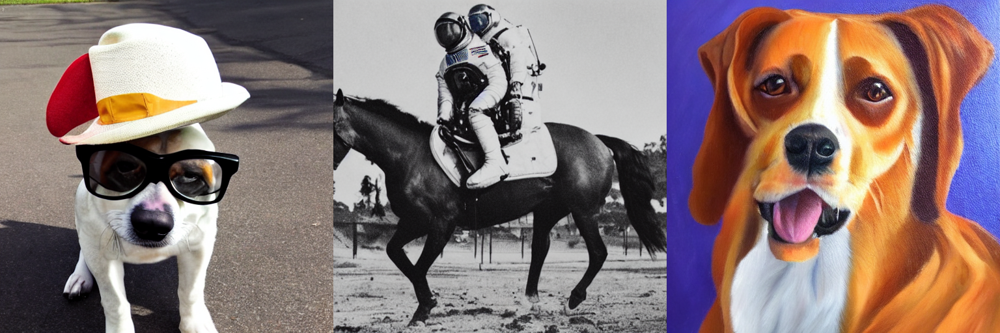

In [ ]:
image_grid(images, rows=1, cols=3)

<figcaption align = "center">
        <h4>Fig 3: Images generated by pipeline for multiple prompts(A photograph of a dog wearing hat and glasses, A photograph of an astronaut riding horse, An oil painting of dog")</h4>
</figcaption>

# Callbacks

You might have observed that before producing the output, there is a progress bar with certain number of steps being completed after which image is generated. Let's visualize what happens during each step using ```latents_callback``` function

In [ ]:
vae = pipe.vae
images = []

def latents_callback(i, t, latents):
    latents = 1 / 0.18215 * latents
    image = vae.decode(latents).sample[0]
    image = (image / 2 + 0.5).clamp(0, 1)
    image = image.cpu().permute(1, 2, 0).numpy()
    images.extend(pipe.numpy_to_pil(image))


torch.manual_seed(9000)
for prompt in prompts:
    final_images = pipe(prompt, callback=latents_callback, callback_steps=12).images[0]
    images.append(final_images)

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

  0%|          | 0/51 [00:00<?, ?it/s]

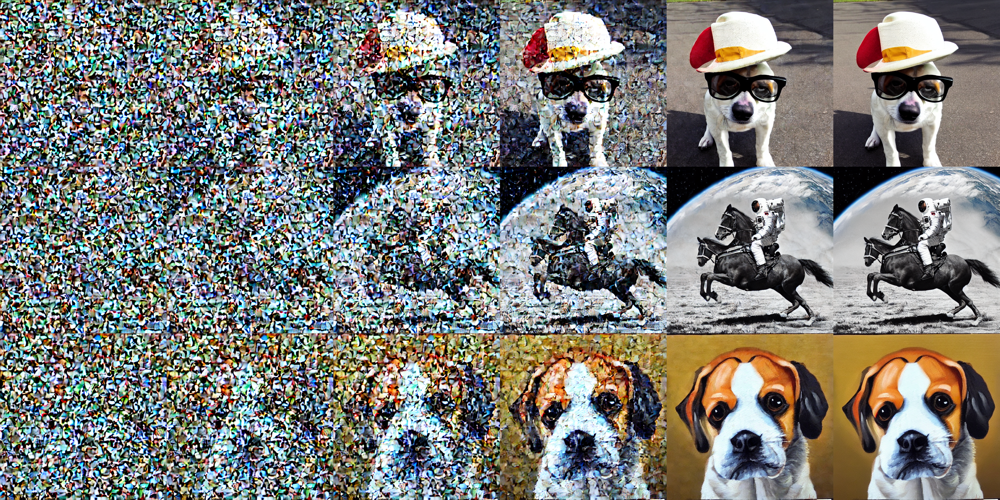

In [ ]:
image_grid(images, rows=len(prompts),cols=6)

<figcaption align = "center">
        <h4>Fig 4: Visualizing Diffusion steps</h4>
</figcaption>

You can see in the above image that at first step for all prompts, there is only random noise and as the steps are increased we start to get images representing the prompts. So how is the model able to generate images from random noise and text? How is StableDiffusion model working?. Let's try to answer our questions by looking under the hood of StableDiffusionPipeline

# Deep Dive

Stable Diffusion is based on a progressive denoising algorithm that is able to create images from pure random noise. These models start with pure random noise and with each step it improves the quality of generated images. Models in this family are known as diffusion models. In case of our above examples in Fig 4, the model took 51 steps and as you can see it improves the quality of generated images with each step. We can define the number of steps the model can take with ```num_inference_steps``` parameter. 

Stable Diffusion is based on a particular type of diffusion model called Latent Diffusion, proposed in [High-Resolution Image Synthesis with Latent Diffusion Models](https://arxiv.org/abs/2112.10752). The difference between the Standard diffusion and latent diffusion models is that when generating high-resolution images in latent diffusion the model works on the to latent(compressed) representation of the images whereas the Standard diffusion model works on actual pixel space. 

For example, consider an image of size 512x512 needs to be generated. The Standard diffusion model works on this pixel space which is of 512x512 and starts with noise of dimensions 512x512. This is expensive as it takes more memory. But in case of Latent Diffusion, the model works on noise which in our above examples is 64x64 and then scaled to 512x512 size images. This scaling is done by models known as Autoencoder which will be explained in next section.

The three main components in latent diffusion are <br>

1. An autoencoder, in our case, a Variational Auto Encoder (VAE)<br>
2. Text-encoder, in our case, a CLIP Text Enocder<br>
3. U-Net<br>

## Autoencoder

<figure align = "center">
<img src="https://d3i71xaburhd42.cloudfront.net/b1786e74e233ac21f503f59d03f6af19a3699024/2-Figure1-1.png" width="800">
    <figcaption align = "center">
        <h4>Fig 5:Autoencoder <a href="https://www.semanticscholar.org/paper/A-Better-Autoencoder-for-Image%3A-Convolutional-Zhang/b1786e74e233ac21f503f59d03f6af19a3699024">(Image Credit)</a></h4>
</figcaption>
</figure>



Autoencoders are models which take images as input and produce same images as output. So you might think how is this model even useful if it is producing same output as input. It is useful because autoencoder is made up of two parts and after training autoencoder these two parts can be used independently. The two parts are<br>
1. Encoder - Takes image as input and converts it to low dimensional latent representation ie compressed data<br>
2. Decoder - Takes compressed data and converts it back into an image<br>

These models can be used for various applications. For example, it can be used as a compression application, where the encoder squishes the image into lower dimensions which uses less memory for storing and when the image is required we can recreate by passing the squished data to decoder. It is to be noted that the compression and decompression by the encoder-decoder is not lossless.

The Latent diffusion models as mentioned in the previous section works on the latent space. This latent space is produced by Encoder of Variational Autoencoder(VAE) and once we have our desired latent outputs produced by the model through diffusion process, we can convert them back to high-resolution images using VAE's decoder

In case of Image to Image StableDiffusion Pipeline, the input image is passed through the VAE's encoder and the latent inputs obtained combined with random noise are used to perform diffusion. The latent outputs produced by the diffusion process is then converted back to high resolution image using VAE's decoder

In case of Text to Image StableDiffusion pipeline, only random noise is used to perform diffusion and the latent outputs produced is converted back high-resolution image using VAE's decoder


Now let's look into the VAE code. HuggingFace Diffusers library already provides us with a pretrained Autoencoder to use which can be imported as below

In [ ]:
#| output: false
from diffusers import AutoencoderKL
vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="vae")
vae.to(torch_device)

AutoencoderKL(
  (encoder): Encoder(
    (conv_in): Conv2d(3, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (down_blocks): ModuleList(
      (0): DownEncoderBlock2D(
        (resnets): ModuleList(
          (0): ResnetBlock2D(
            (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
            (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (norm2): GroupNorm(32, 128, eps=1e-06, affine=True)
            (dropout): Dropout(p=0.0, inplace=False)
            (conv2): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (nonlinearity): SiLU()
          )
          (1): ResnetBlock2D(
            (norm1): GroupNorm(32, 128, eps=1e-06, affine=True)
            (conv1): Conv2d(128, 128, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
            (norm2): GroupNorm(32, 128, eps=1e-06, affine=True)
            (dropout): Dropout(p=0.0, inplace=False)
            (conv2): Conv2d(128, 128, kernel_size=(3,

In [ ]:
#| code-fold: true
def pil_to_latents(input_img):
    with torch.no_grad():
        latent = vae.encode(tfms.ToTensor()(input_img).unsqueeze(0).to(torch_device)*2-1)
    return 0.18215 * latent.latent_dist.sample()

def create_image(t):
    image = (t/2 +0.5).clamp(0,1).detach().cpu().permute(1,2,0).numpy()
    return Image.fromarray((image*255).round().astype("uint8"))

def latents_to_pil(latents):
    latents = (1/0.18215) * latents
    with torch.no_grad():
        images = vae.decode(latents).sample
    pil_images =[create_image(image) for image in images]
    return pil_images

Let's download an image from internet, compress the image using Encoder and view the latent representation. We will use ```pil_to_latents``` helper function to do it

  % Total    % Received % Xferd  Average Speed   Time    Time     Time  Current
                                 Dload  Upload   Total   Spent    Left  Speed
100 62145  100 62145    0     0   240k      0 --:--:-- --:--:-- --:--:--  240k


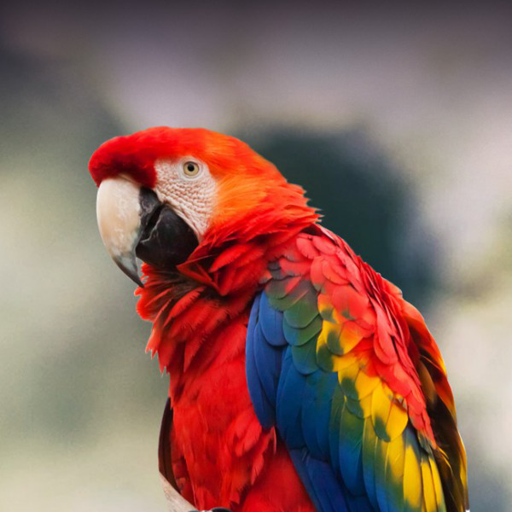

In [ ]:
#| fig-align: center
!curl --output macaw.jpg 'https://lafeber.com/pet-birds/wp-content/uploads/2018/06/Scarlet-Macaw-2.jpg'
input_image = Image.open('macaw.jpg').resize((512, 512))
input_image

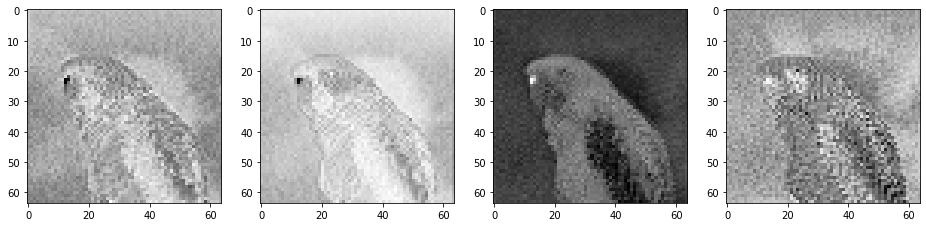

In [ ]:
encoded = pil_to_latents(input_image)
fig, axs = plt.subplots(1, 4, figsize=(16, 4))
for c in range(4):
    axs[c].imshow(encoded[0][c].cpu(), cmap='Greys')

<figcaption align = "center">
        <h4>Fig 6: Latent Representation of the Input image</h4>
</figcaption>

In [ ]:
encoded.shape,tfms.ToTensor()(input_image).unsqueeze(0).shape

(torch.Size([1, 4, 64, 64]), torch.Size([1, 3, 512, 512]))

As you can see the VAE has compressed 3x512x512 image into 4x64x64 image. That is a compression ratio of 48x. These latent representation has captured information about the original image and on passing them to the VAE's decoder provide the original image. For this we use the ```latents_to_pil``` function.

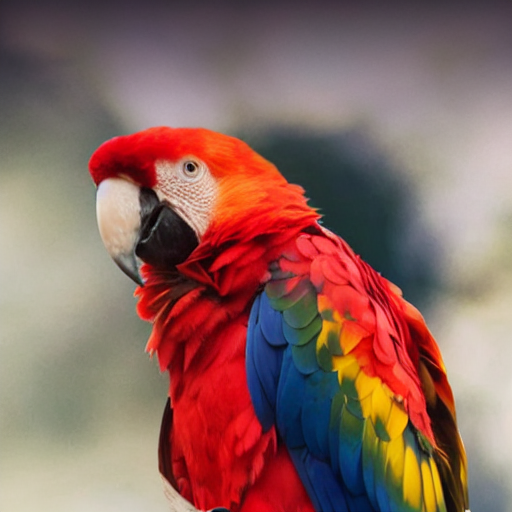

In [ ]:
#| fig-align: center
decoded = latents_to_pil(encoded)[0]
decoded

So we understood how Stable diffusion can create images from random noise using diffusion process. But how is it able to generate images representing the text? Let's find out in the next section.

## Text Encoder

Deep Learning models only understand numbers and not text. So inorder to convert the text data into numbers which our models can work with Tokenizers and Text Encoders are used

<figure align = "center">
<img src="https://developers.google.com/static/machine-learning/guides/text-classification/images/EmbeddingLayer.png" width="800">
    <figcaption align = "center">
        <h4>Fig 7 : Tokenizer and Text Encoder <a href="https://developers.google.com/machine-learning/guides/text-classification/step-3">(Image Credit)</a></h4>
</figcaption>
</figure>

This process of converting text to numbers is done in two steps:<br>
1. Tokenizer - The prompt provided is broken down into words and then it uses a lookup table to convert them into a number. As you can see in the Fig 7 , the input sentences are converted to numbers using the lookup table<br>
2. Text Encoder - This converts numbers into a high dimensional vectors which captures the meaning of the words. These are called embeddings. In Fig 7, the Text Encoder is represented as Embedding layer.<br>

### What is embedding?

Embedding is a high dimensional vector that allows words with similar meaning to have the same representation. It can approximate the meaning of the word. An embedding with 50 values holds the capability of representing 50 unique features. This is known as embedding size. In the Fig 7, the embedding size used to represent each word is 4

### How CLIP model works

The embedding from the text encoder in the Fig 7 represents the meaning of each word in the given prompt. But we also need the same embeddings to represent an image which is described in the prompt. We need a model that connects text and images. CLIP model acts as bridge that connects texts and images


<figure align = "center">
<img src="https://cdn.dida.do/blog/20210621_fg_clip/contrastive_pretraining.png" width="800" >
    <figcaption align = "center">
        <h4>Fig 8 : CLIP model <h7><a href="https://arxiv.org/abs/2103.00020">(Image Credit)</a></h7></h4>
</figcaption>
</figure>


The CLIP model consists of two sub-models called encoders:<br>
1. Text Encoder - Converts text to embeddings<br>
2. Image encoder - Converts Image to embedding<br>

The embeddings produced by both the encoders needs to be similar if both text and image represent same thing and should be different otherwise

For example, lets consider the embedding size as 4. Suppose the text "pepper the aussie pup" when passed to Text encoder produces embeddings (0, 0.5, 0.8, 0.1) then the embeddings generated when image of the Pepper the Aussie Pup is passed to the Image encoder should be similar to that produced by the text encoder ie (0.05, 0.52, 0.78, 0.13). You can learn more about the CLIP model [here](https://openai.com/blog/clip/)

We use the pretrained Text Encoder of the CLIP model to generate embeddings for our prompts. Let's look into the CLIPTextEncoder code 

In [ ]:
prompt = 'A picture of a puppy'

In [ ]:
from transformers import CLIPTokenizer, CLIPTextModel

tokenizer = CLIPTokenizer.from_pretrained("openai/clip-vit-large-patch14")
text_encoder = CLIPTextModel.from_pretrained("openai/clip-vit-large-patch14")
text_encoder = text_encoder.to(torch_device)

Tokenizer expects 77 length vector. So the padding token 49407 is repeated till the length of 77 is reached. The embedding size of the CLIPTextModel is 768. 

In [ ]:
text_input = tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, trucation=True, return_tensors="pt")
text_input['input_ids'][0]

tensor([49406,   320,  1674,   539,   320,  6829, 49407, 49407, 49407, 49407,
        49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
        49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
        49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
        49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
        49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
        49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407, 49407,
        49407, 49407, 49407, 49407, 49407, 49407, 49407])

We can find to which word each number is mapped using tokenizer's decoder.

In [ ]:
for t in text_input['input_ids'][0][:8]:print(t, tokenizer.decoder.get(int(t)))

tensor(49406) <|startoftext|>
tensor(320) a</w>
tensor(1674) picture</w>
tensor(539) of</w>
tensor(320) a</w>
tensor(6829) puppy</w>
tensor(49407) <|endoftext|>
tensor(49407) <|endoftext|>


The numbers from Tokenizer is passed to Text encoder to generate embeddings

In [ ]:
output_embeddings = text_encoder(text_input.input_ids.to(torch_device))[0]
output_embeddings

tensor([[[-0.3884,  0.0229, -0.0522,  ..., -0.4899, -0.3066,  0.0675],
         [ 0.0290, -1.3258,  0.3085,  ..., -0.5257,  0.9768,  0.6652],
         [ 0.6942,  0.3538,  1.0991,  ..., -1.5716, -1.2643, -0.0121],
         ...,
         [-0.0221, -0.0053, -0.0089,  ..., -0.7303, -1.3830, -0.3011],
         [-0.0062, -0.0246,  0.0065,  ..., -0.7326, -1.3745, -0.2953],
         [-0.0536,  0.0269,  0.0444,  ..., -0.7159, -1.3634, -0.3075]]],
       device='cuda:0', grad_fn=<NativeLayerNormBackward0>)

### Classifier- Free Guidance

Classifier-Free Guidance is a method to increase the adherence of the output to the text provided as input. Roughly speaking, the larger the guidance the more the model tries to represent the text prompt. The default value of guidance is 7.5

In order to implement this, along with the embeddings from the prompt we also pass embeddings for an empty string.This is known as Unconditional embedding. This helps the model to go in which ever direction it wants as long as it results in a reasonably-looking image. The prediction are then calculated as follows

```
prediction = unconditional_output + guidance(text_output - unconditional_output)

```

In [ ]:
max_length = text_input.input_ids.shape[-1]
uncond_input = tokenizer([""] * len(prompts), padding="max_length", max_length=max_length, return_tensors="pt")
uncond_embeddings = text_encoder(uncond_input.input_ids.to(torch_device))[0]
emb = torch.cat([uncond_embeddings, output_embeddings])

## UNet

The UNet is the model which produces latent outputs by removing noise. 

UNet model takes three inputs: <br>
1. Noisy latent or Noise - If initial image is provided, noisy latents are produced by adding VAE encoder's latents and noise otherwise it takes pure noise as input and produces new image based on the textual description<br>
2. Timestep - Timestep is the number of times the diffusion process is repeated. It takes as input the current timestep<br>
3. Embeddings - Embeddings generated by CLIP for the input prompts and unconditional embeddings<br>

The UNet model predicts the noise which is then subtracted from the Noisy latents. This process is repeated for the timesteps mentioned and at the end, the latent outputs produced are passed to VAE's decoder to generate High-resolution image

<figure align = "center">
<img src="https://miro.medium.com/max/720/0*4CMZbQvwXaSjQRRX.png" width="800" >
    <figcaption align = "center">
        <h4>Fig 9 : UNet <a href="https://towardsdatascience.com/stable-diffusion-using-hugging-face-501d8dbdd8#:~:text=Stable%20diffusion%20only%20uses%20a,are%20similar%20in%20latent%20space.">(Image Credit)</a></h4>
</figcaption>
</figure>

Let's look into the code for UNet. Along with UNet we also import a scheduler. Scheduler determines the amount of noise to be added to latent at a given step in diffusion process

In [ ]:
#| output: false
from diffusers import UNet2DConditionModel, LMSDiscreteScheduler

scheduler = LMSDiscreteScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", num_train_timesteps=1000)
scheduler.set_timesteps(51)

unet = UNet2DConditionModel.from_pretrained("CompVis/stable-diffusion-v1-4", subfolder="unet")
unet.to(torch_device)

UNet2DConditionModel(
  (conv_in): Conv2d(4, 320, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
  (time_proj): Timesteps()
  (time_embedding): TimestepEmbedding(
    (linear_1): Linear(in_features=320, out_features=1280, bias=True)
    (act): SiLU()
    (linear_2): Linear(in_features=1280, out_features=1280, bias=True)
  )
  (down_blocks): ModuleList(
    (0): CrossAttnDownBlock2D(
      (attentions): ModuleList(
        (0): Transformer2DModel(
          (norm): GroupNorm(32, 320, eps=1e-06, affine=True)
          (proj_in): Conv2d(320, 320, kernel_size=(1, 1), stride=(1, 1))
          (transformer_blocks): ModuleList(
            (0): BasicTransformerBlock(
              (attn1): CrossAttention(
                (to_q): Linear(in_features=320, out_features=320, bias=False)
                (to_k): Linear(in_features=320, out_features=320, bias=False)
                (to_v): Linear(in_features=320, out_features=320, bias=False)
                (to_out): ModuleList(
                

You can see the amount of noise added in each step below. This is called sigmas. The noise added is highest at first step and is gradually decreased in the following steps until it becomes zero at the last step

In [ ]:
print(scheduler.sigmas)

tensor([14.6146, 12.9679, 11.5454, 10.3129,  9.2414,  8.3072,  7.4900,  6.7731,
         6.1422,  5.5854,  5.0924,  4.6547,  4.2650,  3.9169,  3.6051,  3.3251,
         3.0728,  2.8449,  2.6383,  2.4507,  2.2797,  2.1235,  1.9804,  1.8488,
         1.7276,  1.6156,  1.5118,  1.4154,  1.3255,  1.2415,  1.1629,  1.0890,
         1.0193,  0.9535,  0.8912,  0.8319,  0.7754,  0.7213,  0.6695,  0.6195,
         0.5712,  0.5242,  0.4784,  0.4333,  0.3885,  0.3437,  0.2981,  0.2505,
         0.1989,  0.1379,  0.0292,  0.0000])


Let's add noise to the latents obtained from VAE's encoder earlier and see how U-Net removes noise

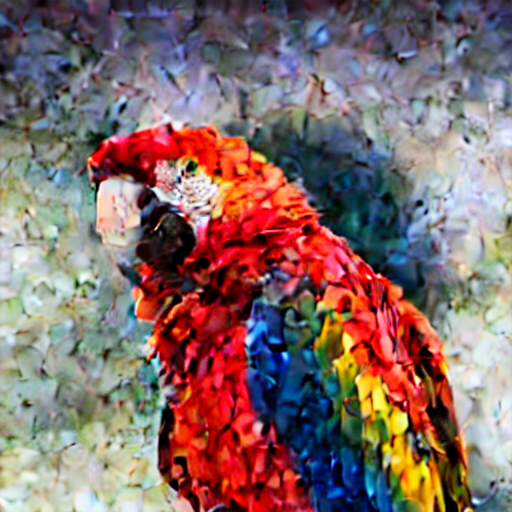

In [ ]:
#| fig-align: center
noise = torch.randn_like(encoded)
encoded_and_noised = scheduler.add_noise(encoded, noise, timesteps=torch.tensor([scheduler.timesteps[40]]))
latents_to_pil(encoded_and_noised)[0]

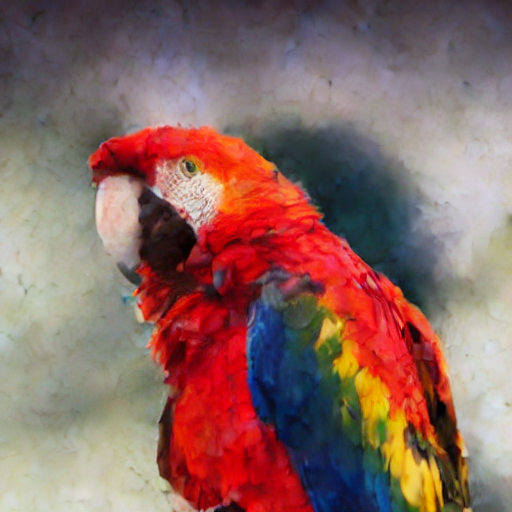

In [ ]:
#| fig-align: center
#Unconditional prompt
prompt=[""]

## tokenizing and getting embeddings from clip model
text_input = tokenizer(prompt, padding="max_length", max_length=tokenizer.model_max_length, truncation=True, return_tensors="pt")

with torch.no_grad():
    text_embeddings=text_encoder(text_input.input_ids.to("cuda"))[0]

#Using U-Net to predict noise
latent_model_input = torch.cat([encoded_and_noised.to("cuda").float()])
with torch.no_grad():
    noise_pred = unet(latent_model_input, 40, encoder_hidden_states=text_embeddings)["sample"]

#Visualize after subtracting noise
latents_to_pil(encoded_and_noised -noise_pred)[0]

You can see that the output image is clearer than the provided noisy image. 

# Implementing StableDiffusionPipeline

<figure align = "center">
<img src="https://miro.medium.com/max/720/0*z5eQUBRBVtgD3Vgv.png" width="800" >
    <figcaption align = "center">
        <h4>Fig 10 : Diffusion process <a href="https://medium.com/towards-data-science/stable-diffusion-using-hugging-face-501d8dbdd8">(Image Credit)</a></h4>
</figcaption>
</figure>

<p>Now that we have understood the core components of the StableDiffusion, let's summarize the diffusion process<br>
1. The prompts provided by the end user is converted to embeddings by the CLIPTextModel<br>
2. If input image is provided, <br>
&emsp;- It is converted to latents by the VAE's encoder and combined with noise from the Scheduler. <br>
 Else,<br>
    &emsp;- Random noise is generated and combined with noise from the Scheduler <br>
3. The embeddings (textual and unconditional) and the latents are provided as input to the UNet along with the current timestep <br> 
4. UNet predicts noise and this noise is removed from the latents. This process is repeated N times ie num_inference_steps <br> 
5. The latents produced by the UNet are passed to VAE's decoder to get high resolution image <br></p>

     
Finally, let's try to implement ```StableDiffusionPipeline``` using these core components. Let's call our pipeline as ```SDPipeline```

## Intialize models
First lets import the model required from diffusers and transformers library. We then create a class ```SDPipeline``` and the ```__init__``` method takes model_path as input which in our case is ```CompVis/stable-diffusion-v1-4```

In [ ]:
from transformers import CLIPTextModel, CLIPTokenizer
from diffusers import AutoencoderKL, UNet2DConditionModel, LMSDiscreteScheduler

In [ ]:
class SDPipeline():
    def __init__(self, model_path):
        self.model_path=model_path
        self.vae = AutoencoderKL.from_pretrained(model_path,subfolder="vae" ,torch_dtype=torch.float16).to(torch_device)
        self.unet=UNet2DConditionModel.from_pretrained(model_path, subfolder="unet", torch_dtype=torch.float16).to(torch_device)
        self.text_encoder = CLIPTextModel.from_pretrained(model_path, subfolder="text_encoder", torch_dtype=torch.float16).to(torch_device)
        self.tokenizer = CLIPTokenizer.from_pretrained(model_path, subfolder="tokenizer", torch_dtype=torch.float16)
        self.scheduler = LMSDiscreteScheduler(beta_start=0.00085, beta_end=0.012, beta_schedule="scaled_linear", num_train_timesteps=1000)


## Tokenize Texts

As explained under Classifier-Free Guidance, we not only pass the embeddings of the prompt but also embeddings for empty string. So let's create a function which tokenizes and provides embeddings. We can make use of the dynamic nature of the Python language to add this function dynamically to class ```SDPipeline```

In [ ]:
def encode_text(self, prompts, maxlen=None):
    if maxlen is None: maxlen = self.tokenizer.model_max_length
    inp = self.tokenizer(prompts, padding="max_length", max_length=maxlen, truncation=True, return_tensors="pt")
    return self.text_encoder(inp.input_ids.to(torch_device))[0].half()

SDPipeline.encode_text = encode_text

## Diffusion Loop

The diffusion loop includes all the steps which we summarized at the starting of this section. We can also add this to class ```SDPipeline```

In [ ]:
def diff_pipeline(self,prompts, guidance=7.5, inference_steps=51, seed=100, callbacks=[], callback_steps=None):
        #calculate number of prompts
        batch_size = len(prompts)
        
        #generate text_embeddings
        cond   = self.encode_text(prompts)
        
        #generate unconditional embeddings and concat them
        uncond = self.encode_text([""]*batch_size, cond.shape[1])
        emb    = torch.cat([uncond, cond])
        if seed : torch.manual_seed(seed)
        
        #generate random noise and add noise
        latents = torch.randn((batch_size, self.unet.in_channels, 512//8, 512//8))
        
        #Setting number of steps in scheduler
        self.scheduler.set_timesteps(inference_steps)
        
        #Add noise to latents
        latents = latents.to(torch_device).half() * self.scheduler.init_noise_sigma

        for i, t in enumerate(tqdm(self.scheduler.timesteps)):
            # scale the latents for particular timestep
            inp = self.scheduler.scale_model_input(torch.cat([latents]*2), t)
            
            #predict noise using UNet
            with torch.no_grad():u,c = self.unet(inp, t, encoder_hidden_states=emb).sample.chunk(2)
                
            #Perform Classifier-Free Guidance    
            pred = u + guidance*(c-u)
            
            #Removing predicted noise from the latents
            latents = self.scheduler.step(pred, t, latents).prev_sample
            
            #run callbacks if any are added
            if len(callbacks):
                if i%callback_steps==0:
                    for callback in callbacks: callback(i, t, latents)
        
        #after loop is completed, pass the latents to VAE's decoder and return the High-resolution image generated
        with torch.no_grad():
            return self.vae.decode(1/0.18125 * latents).sample

In [ ]:
SDPipeline.__call__ = diff_pipeline

## Adding Callback
Let's create a callback as well, which will help to visualize the steps like we did at the starting . We will create a class which stores intermediate steps images. Since they are latents we use VAE to decode and display for us

In [ ]:
vae = AutoencoderKL.from_pretrained("CompVis/stable-diffusion-v1-4",subfolder="vae" ,torch_dtype=torch.float16).to(torch_device)
class Latents_Callback:
    def __init__(self, prompts):
        self.imgs = [[] for _ in range(len(prompts))]
    
    def __call__(self, i, t, latents):
        latents = 1 / 0.18215 * latents
        for i in range(latents.shape[0]):
            callback_imgs = vae.decode(latents).sample[i]
            callback_imgs = create_image(callback_imgs)
            self.imgs[i].append(callback_imgs)

## Running our SDPipeline

In [ ]:
prompts = [
    'a photograph of an astronaut riding a horse',
    'an oil painting of an astronaut riding a horse in the style of grant wood',
    'a painting of dog wearing suit'
]

Initializing callbacks and SDPipeline objects

In [ ]:
lc = Latents_Callback(prompts)

In [ ]:
pipe = SDPipeline("CompVis/stable-diffusion-v1-4")

Downloading:   0%|          | 0.00/592 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/492M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/525k [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/472 [00:00<?, ?B/s]

Downloading:   0%|          | 0.00/806 [00:00<?, ?B/s]

Let's pass the prompts and the callback object to the SDPipeline object ```pipe```. We can see the images generated for each prompt and can also visualize the steps by displaying images saved in the callback object

In [ ]:
images = pipe(prompts, callbacks=[lc], callback_steps=12)

  0%|          | 0/51 [00:00<?, ?it/s]

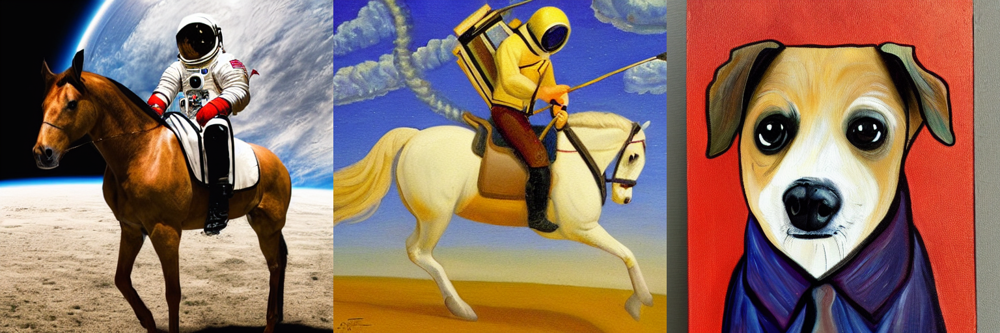

In [ ]:
imgs = [create_image(i) for i in images]
image_grid(imgs, rows=1, cols = len(imgs))

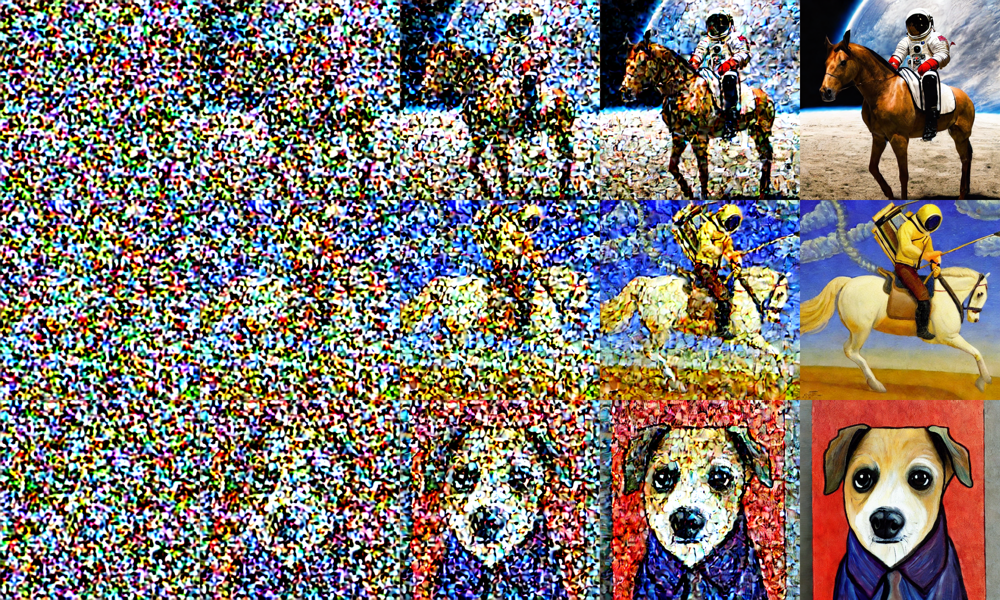

In [ ]:
rows, cols = len(prompts), len(lc.imgs[0])
imgs =[img for i in range(len(prompts)) for img in lc.imgs[i]]
image_grid(imgs, rows=rows, cols=cols)

# Conclusion

In this post, we have covered a brief introduction of Stable diffusion. After that, in later sections we understood each components of the Stable Diffusion model along with code. At the end, we implemented ```SDPipeline``` using the core components, generated images for multiple prompts and also visualized the images generated at particular timesteps.

I hope you enjoyed reading it. If there is any feedback, feel free to reach out on [Linkedin](https://www.linkedin.com/in/prajwal-s-1416061b3/) or on [mail](prajwalsuresh13@gmail.com)

# References

- [FastAI course](https://www.fast.ai/posts/part2-2022-preview.html)
- [Aayush Agrawal's blog](https://aayushmnit.com/blog.html)